<a href="https://colab.research.google.com/github/raajivp/yolov5_training/blob/main/Task_1_instance_retrieval.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!wget "https://4.imimg.com/data4/UN/TI/MY-3286626/plastic-pet-bottle.jpg"  -O pet_bottle.jpg


--2023-10-10 18:59:17--  https://4.imimg.com/data4/UN/TI/MY-3286626/plastic-pet-bottle.jpg
Resolving 4.imimg.com (4.imimg.com)... 18.65.25.115, 18.65.25.102, 18.65.25.95, ...
Connecting to 4.imimg.com (4.imimg.com)|18.65.25.115|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [image/jpeg]
Saving to: ‘pet_bottle.jpg’

pet_bottle.jpg          [ <=>                ]  13.42K  --.-KB/s    in 0s      

2023-10-10 18:59:18 (204 MB/s) - ‘pet_bottle.jpg’ saved [13741]



In [3]:
!python detect.py --weights "/content/drive/MyDrive/yolov5/runs/train/exp/weights/best.pt" --img 640 --conf 0.5 --source pet_bottle.jpg


detect: weights=['/content/drive/MyDrive/yolov5/runs/train/exp/weights/best.pt'], source=pet_bottle.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-226-gdd9e338 Python-3.10.12 torch-2.0.1+cu118 CPU

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/yolov5/pet_bottle.jpg: 640x640 1 pet_bottle, 391.5ms
Speed: 4.9ms pre-process, 391.5ms inference, 23.5ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


In [6]:
import os

In [11]:
dataset_zip_path = "/content/drive/MyDrive/mainbottledataset.zip"


extracted_folder = "/content/dataset1"


os.makedirs(extracted_folder, exist_ok=True)
!unzip -q "$dataset_zip_path" -d "$extracted_folder"

In [24]:
import os


image_dir = "/content/dataset/train/images"

image_fList the first 500 imagesiles = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))][:500]


with open('first_500_images.txt', 'w') as f:
    for image_file in image_files:
        f.write(f"{image_file}\n")


In [25]:
!python detect.py --weights "/content/drive/MyDrive/yolov5/runs/train/exp/weights/best.pt" --img 640 --conf 0.5 --source first_500_images.txt --save-txt


detect: weights=['/content/drive/MyDrive/yolov5/runs/train/exp/weights/best.pt'], source=first_500_images.txt, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-226-gdd9e338 Python-3.10.12 torch-2.0.1+cu118 CPU

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
image 1/500 /content/dataset/train/images/00000006_jpg.rf.3be1f021d187a5813c414b52eb8652ca.jpg: 640x640 3 tetrapacks, 378.5ms
image 2/500 /content/dataset/train/images/00000023_jpg.rf.47c541c7a2c13d107f8ecce58d52d672.jpg: 640x640 3 tetrapacks, 480.7ms
image 3/500 /content/dataset/train/images/00000030_jpg.rf.626fae99b7a5ec9

In [29]:
import glob

detected_pet_bottles = []

for file in glob.glob('runs/detect/exp9/labels/*.txt'):
    with open(file, 'r') as f:
        lines = f.readlines()
        for line in lines:
            values = line.split()
            class_id = int(values[0])
            if class_id == 0:
                detected_pet_bottles.append(file.replace('labels', 'images').replace('.txt', '.jpg'))


In [32]:

original_image_dir = '/content/dataset/train/images'

detected_pet_bottles = [os.path.join(original_image_dir, os.path.basename(file).replace('.txt', '.jpg')) for file in detected_pet_bottles]


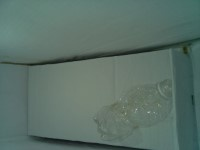

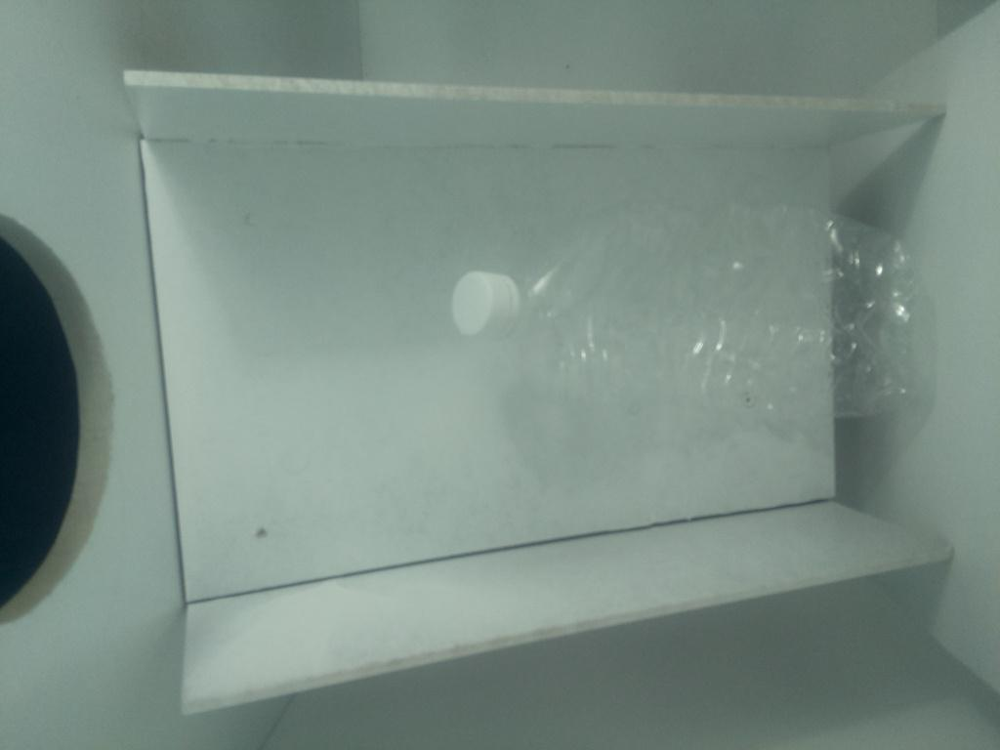

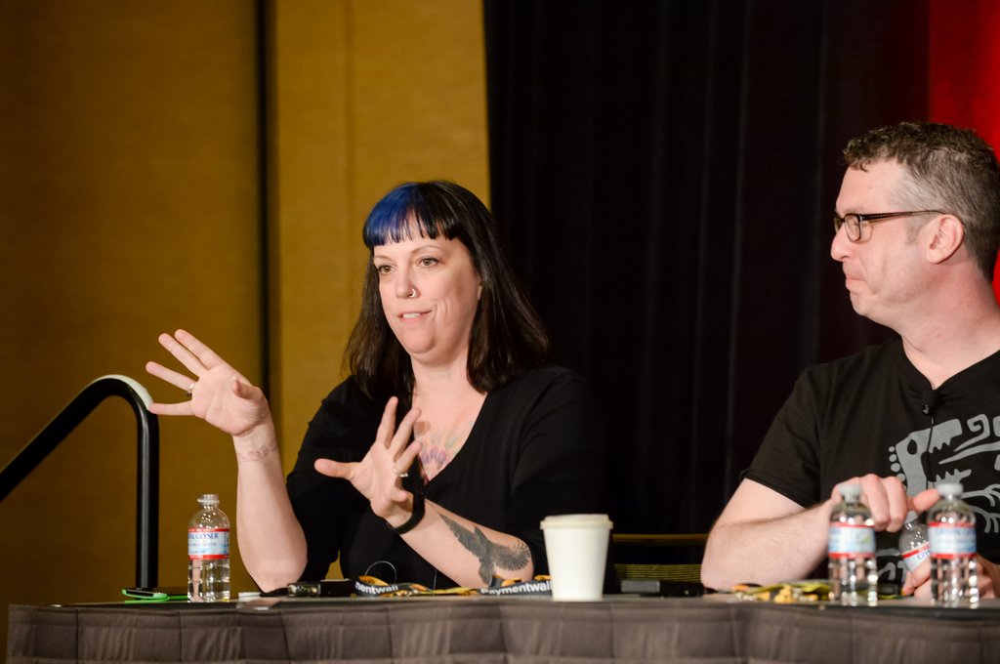

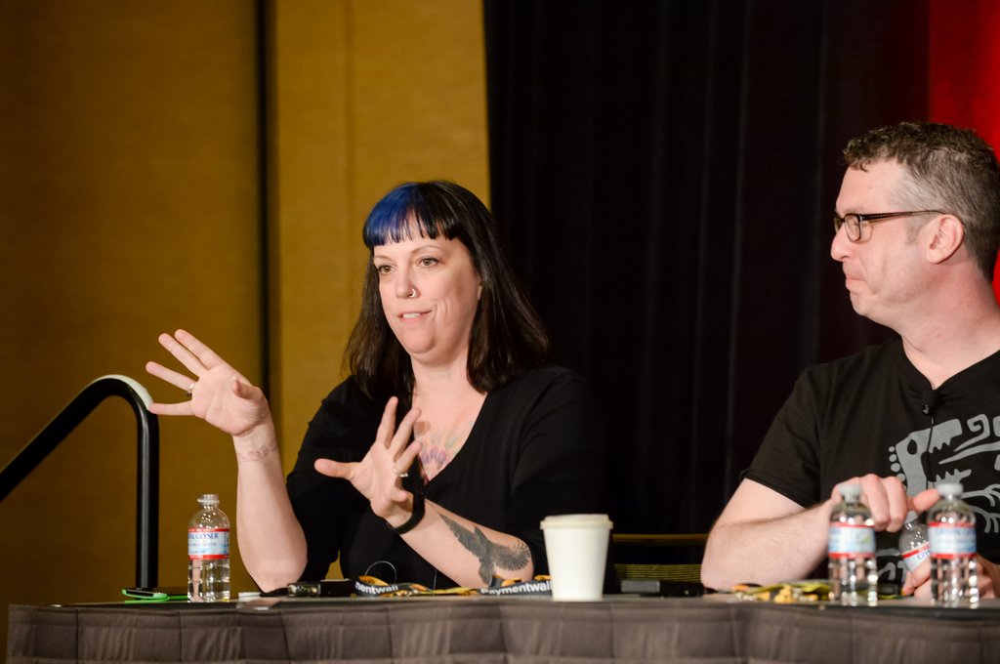

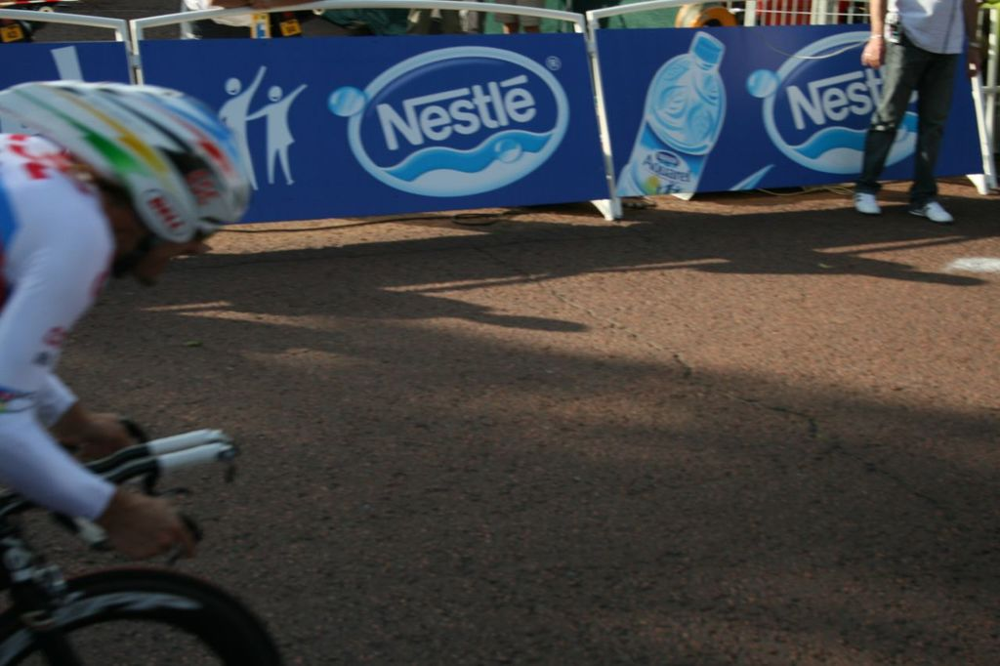

...

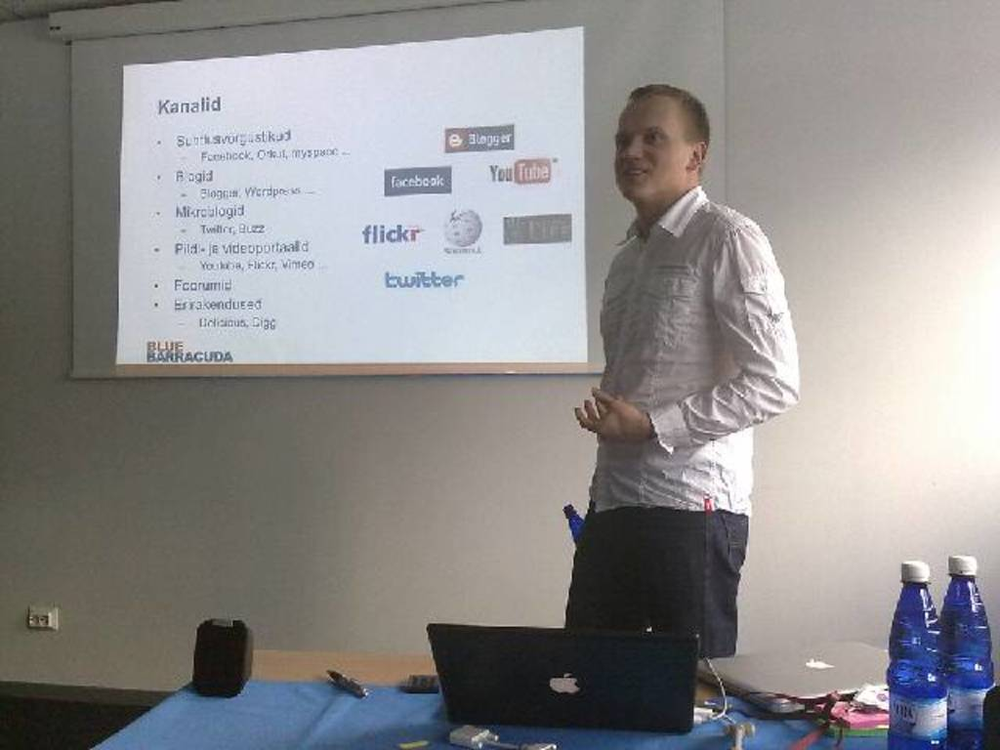

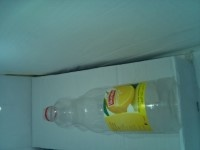

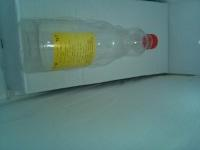

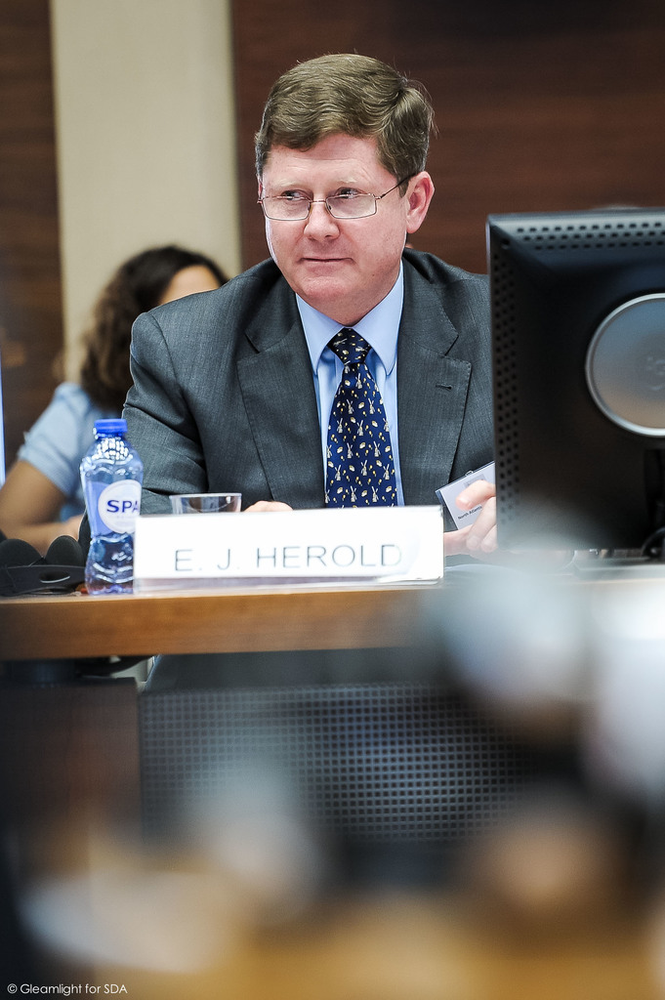

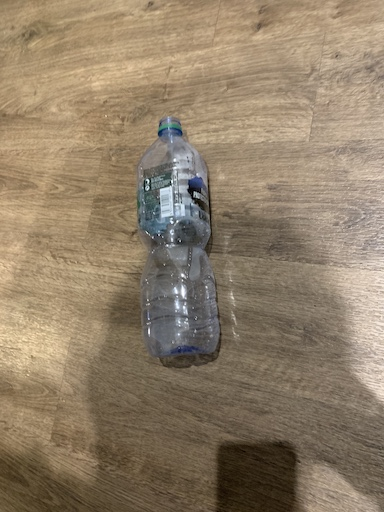

In [33]:
from IPython.display import Image, display

for image_path in detected_pet_bottles:
    display(Image(filename=image_path))


In [ ]:
from google.colab import drive
drive.mount('/content/drive')